In [1]:
# Import matplotlib for animation and other libraries/functions
%matplotlib notebook
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

from pathlib import Path
from PIL import Image
from RNN_classes_funcs_Marchese import get_filenames

In [2]:
# Get filenames of images for animation
path = Path("data_RNN")
all_filenames = get_filenames(path)

# Sort image filenames in sequential order
all_filenames.sort()
all_filenames[:5]

[PosixPath('data_RNN/00001-right-straight.png'),
 PosixPath('data_RNN/00002-straight-right.png'),
 PosixPath('data_RNN/00003-straight-straight.png'),
 PosixPath('data_RNN/00004-straight-straight.png'),
 PosixPath('data_RNN/00005-straight-straight.png')]

In [3]:
# Get list of images given their filenames
frames = [Image.open(file) for file in all_filenames]

<IPython.core.display.Javascript object>


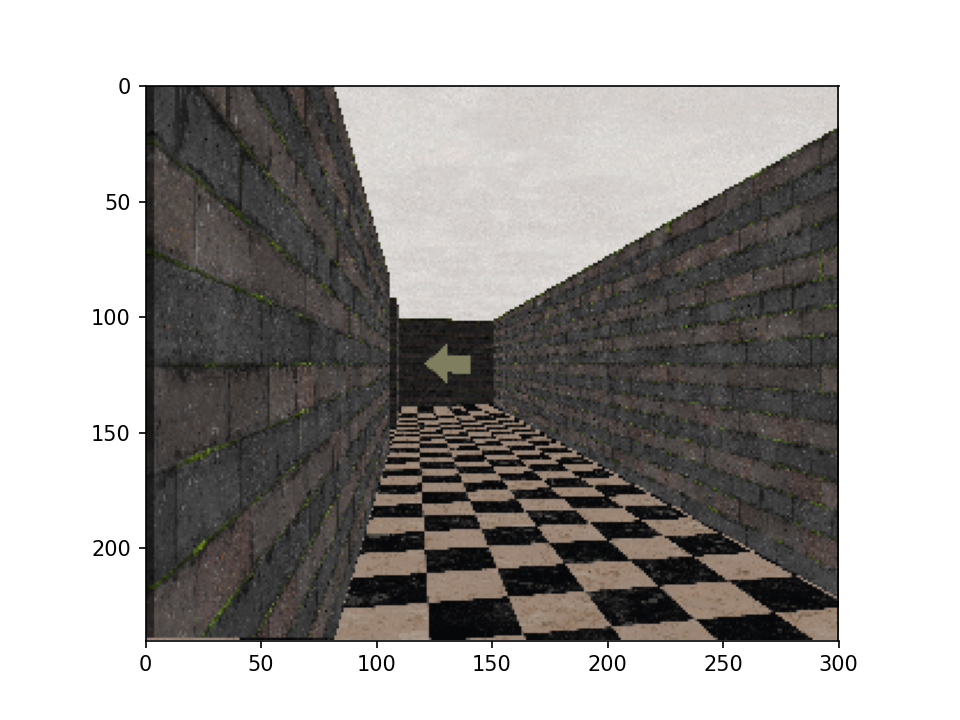

Animation size has reached 21244833 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [4]:
# Initialize subplots
fig, ax = plt.subplots()

# Set axis of animation
ax.set(xlim=(0,300), ylim=(240,0))

# Initialize frame
frame = plt.imshow(frames[0])

def init():
    """
    Creates initial frame for animation.
    
    :return: (list) a list of the initial frame for animation
    """
    frame.set_data(frames[0])
    return [frame]

def animate(i):
    """
    Updates the state of the frame at each point of the animation.
    
    :param i: (ndarray) current image/frame
    :return: (list) a list of the current frame for animation
    """
    # Define the updated content of frame
    frame.set_array(i)
    return [frame]

from IPython.display import HTML

# Take images, functions, and other parameters and create an animation
ani = FuncAnimation(fig, animate, frames[::20], init_func = init, interval = 200)
HTML(ani.to_jshtml())